Data Cleaning

In [82]:
# Import Statements

import pandas as pd
import numpy as np

import requests
from bs4 import BeautifulSoup


import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import string
import regex as re


from nltk.corpus import stopwords
# nltk.download('stopwords')
# nltk.download('punkt')
from nltk import word_tokenize
from nltk import FreqDist

import warnings
warnings.filterwarnings('ignore')

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import recall_score, accuracy_score, f1_score, confusion_matrix, classification_report
from sklearn.utils import class_weight
from sklearn.pipeline import Pipeline
from sklearn.base import TransformerMixin
from sklearn import set_config

from PIL import Image
from wordcloud import WordCloud
from textwrap import wrap

import joblib

In [83]:
df = pd.read_csv(r'..\\data\\best_travel_destinations_for_2025.csv', encoding='latin1')
df.head()

,Attraction,Description,Country,Continent
0,Amboseli National Park,Amboseli belongs in the elite of Kenyaâs nat...,Kenya,Africa
1,Fort Jesus,This 16th-century fort and Unesco World Herita...,Kenya,Africa
2,David Sheldrick Wildlife Trust,"Occupying a plot within Nairobi National Park,...",Kenya,Africa
3,Nairobi National Park,Welcome to Kenyaâs most accessible yet incon...,Kenya,Africa
4,National Museum,"Kenyaâs wonderful National Museum, housed in...",Kenya,Africa


In [84]:
# Previewing the bottom of our dataset
df.tail()

,Attraction,Description,Country,Continent
18035,Byzantine Basilica,Near the Citadel's archaeological museum is th...,Jordan,Middle East
18036,Sharif Al Hussein Bin Ali Mosque,This grand and beautiful gleaming white mosque...,Jordan,Middle East
18037,North Theatre,The North Theatre is overgrown and missing muc...,Jordan,Middle East
18038,Shops,The shells of a row of shops remain in the wes...,Jordan,Middle East
18039,Rakhabat Canyon,"Close to Rum village, the labyrinthine siqs of...",Jordan,Middle East


Data Cleaning

In [85]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18040 entries, 0 to 18039
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Attraction   18040 non-null  object
 1   Description  18040 non-null  object
 2   Country      18040 non-null  object
 3   Continent    18040 non-null  object
dtypes: object(4)
memory usage: 563.9+ KB


In [86]:
df.describe()

,Attraction,Description,Country,Continent
count,18040,18040,18040,18040
unique,17185,18024,25,7
top,Cathedral,Buddhist ruins in Si Satchanalai-Chaliang Hist...,United States,Asia
freq,19,4,1200,4480


In [87]:
df.shape

(18040, 4)

Addressing Missing and Placeholder Values

In [88]:
#check for null values
df.isna().sum()

Attraction     0
Description    0
Country        0
Continent      0
dtype: int64

In [89]:
#looking at duplicates
df.duplicated().sum()

9

We have a total of 9 Duplicate values. We are going to drop them , but befor then, lets check for countries with duplicates 



In [90]:
df[df['Continent'].isna()].head()
print(df)

                             Attraction  \
0                Amboseli National Park   
1                            Fort Jesus   
2        David Sheldrick Wildlife Trust   
3                 Nairobi National Park   
4                       National Museum   
...                                 ...   
18035                Byzantine Basilica   
18036  Sharif Al Hussein Bin Ali Mosque   
18037                     North Theatre   
18038                             Shops   
18039                   Rakhabat Canyon   

                                             Description Country    Continent  
0      Amboseli belongs in the elite of Kenyaâs nat...   Kenya       Africa  
1      This 16th-century fort and Unesco World Herita...   Kenya       Africa  
2      Occupying a plot within Nairobi National Park,...   Kenya       Africa  
3      Welcome to Kenyaâs most accessible yet incon...   Kenya       Africa  
4      Kenyaâs wonderful National Museum, housed in...   Kenya       Africa  
...

In [91]:
df[df['Country'].isna()].head()
print(df)

                             Attraction  \
0                Amboseli National Park   
1                            Fort Jesus   
2        David Sheldrick Wildlife Trust   
3                 Nairobi National Park   
4                       National Museum   
...                                 ...   
18035                Byzantine Basilica   
18036  Sharif Al Hussein Bin Ali Mosque   
18037                     North Theatre   
18038                             Shops   
18039                   Rakhabat Canyon   

                                             Description Country    Continent  
0      Amboseli belongs in the elite of Kenyaâs nat...   Kenya       Africa  
1      This 16th-century fort and Unesco World Herita...   Kenya       Africa  
2      Occupying a plot within Nairobi National Park,...   Kenya       Africa  
3      Welcome to Kenyaâs most accessible yet incon...   Kenya       Africa  
4      Kenyaâs wonderful National Museum, housed in...   Kenya       Africa  
...

In [92]:
# Look at duplicates in one city
#Drop the duplicats
df.drop_duplicates(keep='first', inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18031 entries, 0 to 18039
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Attraction   18031 non-null  object
 1   Description  18031 non-null  object
 2   Country      18031 non-null  object
 3   Continent    18031 non-null  object
dtypes: object(4)
memory usage: 704.3+ KB


In [93]:
#Check to confirm no Duplicates 
df.duplicated().sum()

0

The DataFrame contains 0 duplicate rows. 

### Class Imbalance


In [94]:
display(df.Country.unique())
print('Total Unique Cities:', len(df.Country.unique()))

array(['Kenya', 'South Africa', 'Egypt', 'Morocco', 'Japan', 'China',
       'India', 'Thailand', 'France', 'Italy', 'Germany', 'United States',
       'Canada', 'Mexico', 'Brazil', 'Argentina', 'Chile', 'Peru',
       'Australia', 'New Zealand', 'Fiji', 'United Arab Emirates',
       'Turkey', 'Israel', 'Jordan'], dtype=object)

Total Unique Cities: 25


In [95]:
df.Country.value_counts(normalize=True)

United States           0.066552
Italy                   0.066552
Germany                 0.066552
Australia               0.066552
Japan                   0.066552
France                  0.066552
India                   0.066441
Canada                  0.066441
China                   0.066330
Mexico                  0.059897
Turkey                  0.057678
Thailand                0.048805
South Africa            0.035494
Brazil                  0.033276
Egypt                   0.028839
New Zealand             0.022184
Morocco                 0.019966
Argentina               0.019966
Peru                    0.019966
Chile                   0.017692
Jordan                  0.008874
Israel                  0.008874
Kenya                   0.008874
United Arab Emirates    0.006655
Fiji                    0.004437
Name: Country, dtype: float64

In [96]:
Country = df.groupby('Country').count()

In [97]:
Country.reset_index(inplace=True)

In [98]:
sorted_Country = Country.sort_values(by='Attraction', ascending=False)
sorted_Country

,Country,Attraction,Description,Continent
12,Italy,1200,1200,1200
8,France,1200,1200,1200
13,Japan,1200,1200,1200
1,Australia,1200,1200,1200
9,Germany,1200,1200,1200
24,United States,1200,1200,1200
10,India,1198,1198,1198
3,Canada,1198,1198,1198
5,China,1196,1196,1196
16,Mexico,1080,1080,1080


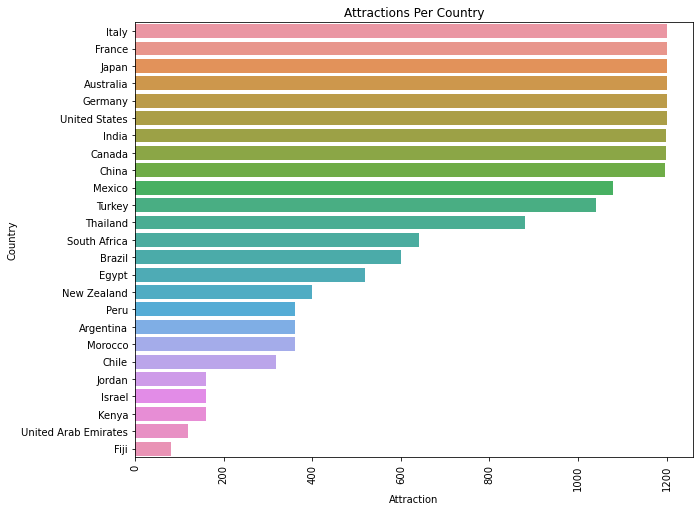

In [99]:
# Plot the class imbalance
plt.figure(figsize=(10,8))
sns.barplot(x='Attraction', y='Country', data=sorted_Country)
plt.title('Attractions Per Country')
plt.xticks(rotation=90)
plt.show()

## Text Cleaning & Preprocessing & More Exploration
- Remove punctuation and numbers
- Lowercase everything
- Remove stopwords
- Create a document term matrix grouped by city 
    - count vectorization
    - tf-idf vectorization
    - bi-grams
- Visualize most frequent words
    - word clouds
    - bar plot/histogram

In [100]:
# Create a list of stopwords
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)

In [101]:
stopwords_list[:5]

['i', 'me', 'my', 'myself', 'we']

In [102]:
# Save stopwords list for app
#joblib.dump(stopwords_list, '/Users/tiaplagata/Documents/Flatiron/capstone-project/Data/stopwords_list')

In [103]:
# Lowercase all words in each corpus
df['cleaned'] = df['Attraction'].apply(lambda x: x.lower())
df.head()

,Attraction,Description,Country,Continent,cleaned
0,Amboseli National Park,Amboseli belongs in the elite of Kenyaâs nat...,Kenya,Africa,amboseli national park
1,Fort Jesus,This 16th-century fort and Unesco World Herita...,Kenya,Africa,fort jesus
2,David Sheldrick Wildlife Trust,"Occupying a plot within Nairobi National Park,...",Kenya,Africa,david sheldrick wildlife trust
3,Nairobi National Park,Welcome to Kenyaâs most accessible yet incon...,Kenya,Africa,nairobi national park
4,National Museum,"Kenyaâs wonderful National Museum, housed in...",Kenya,Africa,national museum


In [104]:
# Remove commas, hyphens, colons, and other punctuation
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
df.head()

,Attraction,Description,Country,Continent,cleaned
0,Amboseli National Park,Amboseli belongs in the elite of Kenyaâs nat...,Kenya,Africa,amboseli national park
1,Fort Jesus,This 16th-century fort and Unesco World Herita...,Kenya,Africa,fort jesus
2,David Sheldrick Wildlife Trust,"Occupying a plot within Nairobi National Park,...",Kenya,Africa,david sheldrick wildlife trust
3,Nairobi National Park,Welcome to Kenyaâs most accessible yet incon...,Kenya,Africa,nairobi national park
4,National Museum,"Kenyaâs wonderful National Museum, housed in...",Kenya,Africa,national museum


In [105]:
# Use regex to get rid of numbers 
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
df.head(10)

,Attraction,Description,Country,Continent,cleaned
0,Amboseli National Park,Amboseli belongs in the elite of Kenyaâs nat...,Kenya,Africa,amboseli national park
1,Fort Jesus,This 16th-century fort and Unesco World Herita...,Kenya,Africa,fort jesus
2,David Sheldrick Wildlife Trust,"Occupying a plot within Nairobi National Park,...",Kenya,Africa,david sheldrick wildlife trust
3,Nairobi National Park,Welcome to Kenyaâs most accessible yet incon...,Kenya,Africa,nairobi national park
4,National Museum,"Kenyaâs wonderful National Museum, housed in...",Kenya,Africa,national museum
5,Giraffe Centre,"This centre, which protects the highly endange...",Kenya,Africa,giraffe centre
6,Lamu Museum,The best museum in town (and the second best i...,Kenya,Africa,lamu museum
7,Galana River,Running through the heart of the park and mark...,Kenya,Africa,galana river
8,Mzima Springs,Mzima Springs is an oasis of green in the west...,Kenya,Africa,mzima springs
9,Ngulia Rhino Sanctuary,"At the base of Ngulia Hills, this 90-sq-km are...",Kenya,Africa,ngulia rhino sanctuary


In [106]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

# Initialize the lemmatizer
lemmatizer = WordNetLemmatizer()

# Tokenize and lemmatize the 'cleaned' column
def lemmatize_text(text):
    tokens = word_tokenize(text)  # Tokenize the text
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]  # Lemmatize the tokens
    return " ".join(lemmatized_tokens)  # Rejoin the tokens into a string

# Apply the lemmatization function to the 'cleaned' column
df['lemmatized'] = df['cleaned'].apply(lemmatize_text)

# Display the resulting DataFrame
print(df[['cleaned', 'lemmatized']])

                                cleaned                        lemmatized
0                amboseli national park            amboseli national park
1                            fort jesus                        fort jesus
2        david sheldrick wildlife trust    david sheldrick wildlife trust
3                 nairobi national park             nairobi national park
4                       national museum                   national museum
...                                 ...                               ...
18035                byzantine basilica                byzantine basilica
18036  sharif al hussein bin ali mosque  sharif al hussein bin ali mosque
18037                     north theatre                     north theatre
18038                             shops                              shop
18039                   rakhabat canyon                   rakhabat canyon

[18031 rows x 2 columns]


In [107]:
# Group the corpora by city and join them
df_to_group = df[['Country', 'lemmatized']]
df_grouped = df_to_group.groupby(by='Country').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
Country,
Argentina,glaciar perito moreno los seismiles palacio ba...
Australia,bondi beach royal botanic garden twelve apostl...
Brazil,parque nacional da tijuca pã£o de aã§ãºcar cop...
Canada,banff national park stanley park lake louise m...
Chile,parque nacional patagonia orongo ceremonial vi...
China,peak tram mogao grotto temple of heaven park a...
Egypt,amun temple enclosure st catherine monastery t...
Fiji,coloisuva forest park fiji museum suva municip...
France,citã© de lâespace eiffel tower centre pompid...


In [108]:
# Save grouped df
df_grouped.to_csv('../Data/df_grouped')

### Look at different vectorization strategies
- Try different vectorization strategies and visualize them with word clouds
    - count vectorization
    - tf-idf vectorization
    - bi-grams

In [109]:
# Create a document term matrix using count vectorization
# Using count vectorization (most simple way to vectorize)
cv = CountVectorizer(analyzer='word', stop_words=stopwords_list)
data = cv.fit_transform(df_grouped['lemmatized'])
df_dtm = pd.DataFrame(data.toarray(), columns=cv.get_feature_names())
df_dtm.index = df_grouped.index
df_dtm

,aachen,aachener,aath,ab,aba,abaca,abad,abakh,aban,abandoned,...,zã³calo,zã¼ber,zã¼beyde,zä,zå,zç,ã³n,ãºcar,ã¼k,ã¼å
Country,,,,,,,,,,,,,,,,,,,,,
Argentina,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2,0,0,0
Australia,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Brazil,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
Canada,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Chile,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
China,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,2,0,0,0,0
Egypt,0,0,0,3,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
Fiji,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
France,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [110]:
# Create a document term matrix using TF-IDF vectorization
# Might be good for classifying cities
tfidf = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
data2 = tfidf.fit_transform(df_grouped['lemmatized'])
df_dtm2 = pd.DataFrame(data2.toarray(), columns=tfidf.get_feature_names())
df_dtm2.index = df_grouped.index
df_dtm2

,aachen,aachener,aath,ab,aba,abaca,abad,abakh,aban,abandoned,...,zã³calo,zã¼ber,zã¼beyde,zä,zå,zç,ã³n,ãºcar,ã¼k,ã¼å
Country,,,,,,,,,,,,,,,,,,,,,
Argentina,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.015991,0.000000,0.000000,0.000000
Australia,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Brazil,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.006286,0.000000,0.000000
Canada,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Chile,0.000000,0.000000,0.000000,0.000000,0.013977,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
China,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.008662,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.017324,0.000000,0.000000,0.000000,0.000000
Egypt,0.000000,0.000000,0.000000,0.040607,0.000000,0.000000,0.000000,0.000000,0.013536,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Fiji,0.000000,0.000000,0.000000,0.000000,0.000000,0.080171,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
France,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### Word Clouds with Count Vectorization

In [111]:
def generate_wordcloud(data, title):
    cloud = WordCloud(width=400, height=330, max_words=150, colormap='tab20c').generate_from_frequencies(data)
    plt.figure(figsize=(10,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,60)), fontsize=13)
    plt.show()

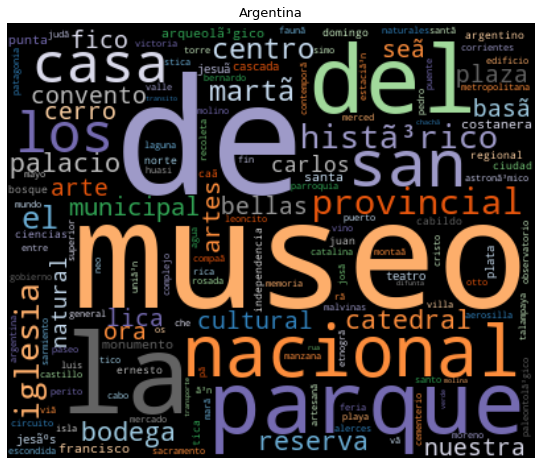

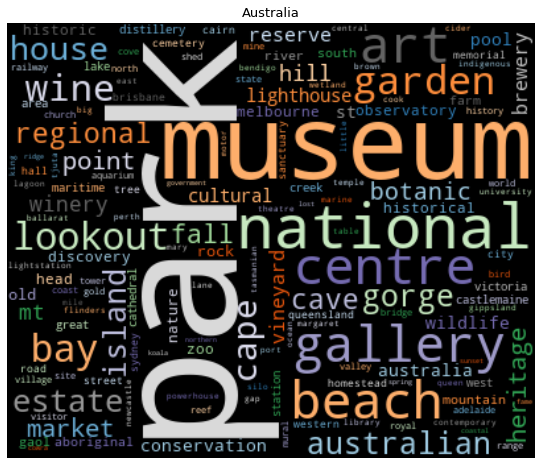

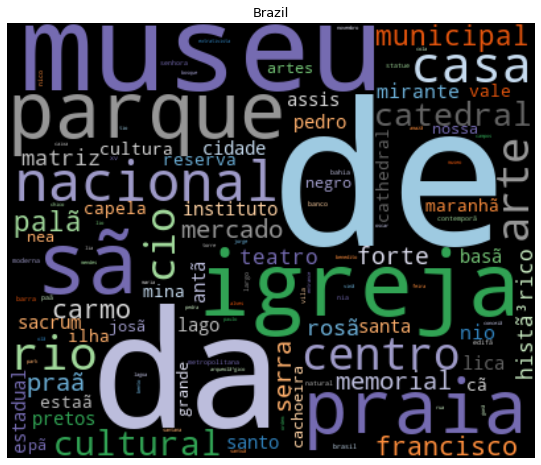

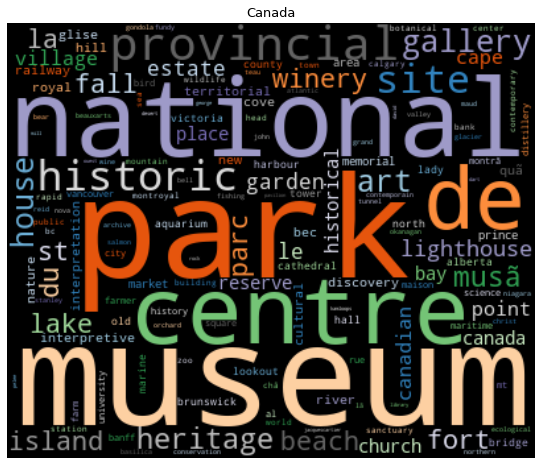

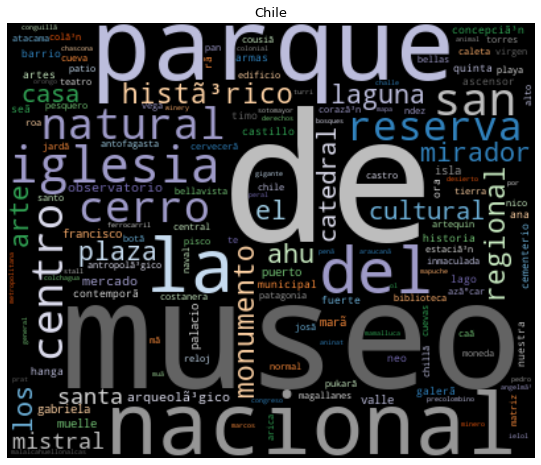

...

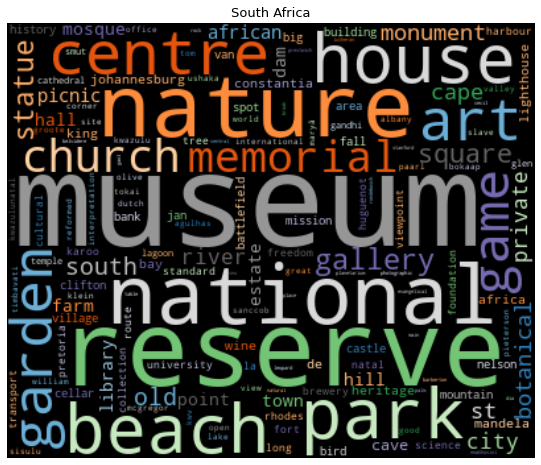

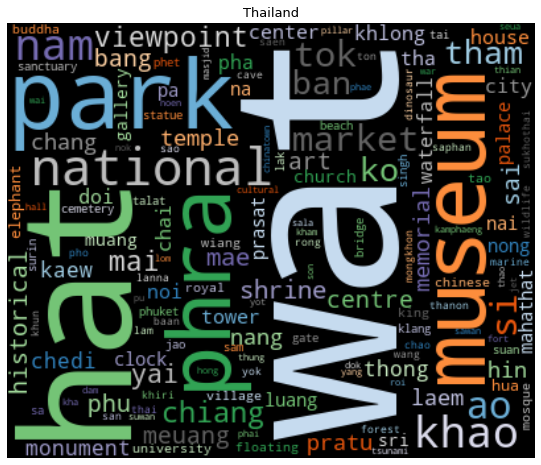

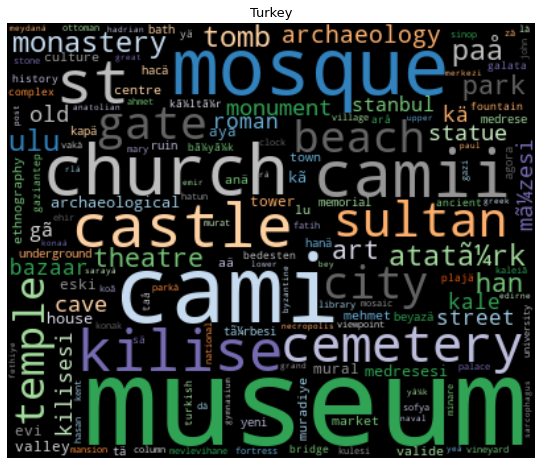

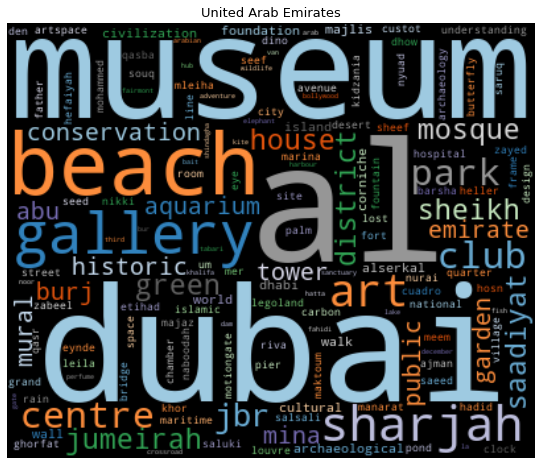

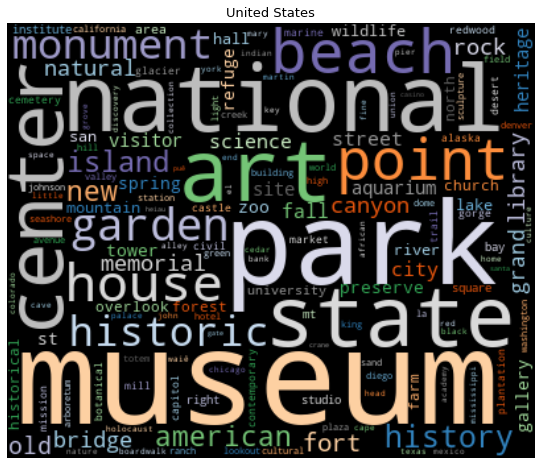

In [112]:
# Transposing document term matrix
df_dtm = df_dtm.transpose()

# Plotting word cloud for each city
for index, Country in enumerate(df_dtm.columns):
    generate_wordcloud(df_dtm[Country].sort_values(ascending=False), Country)

In [114]:
# Look at top words with count vectorizer (in total, not per city)
sum_words = data.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in cv.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
words_freq

[('de', 1760),
 ('museum', 1645),
 ('park', 807),
 ('museo', 620),
 ('national', 544),
 ('la', 535),
 ('art', 441),
 ('temple', 404),
 ('di', 383),
 ('beach', 300),
 ('musã', 289),
 ('centre', 277),
 ('san', 275),
 ('del', 249),
 ('wat', 225),
 ('garden', 224),
 ('st', 219),
 ('house', 214),
 ('gallery', 209),
 ('church', 165),
 ('parque', 164),
 ('du', 155),
 ('memorial', 149),
 ('reserve', 143),
 ('casa', 137),
 ('nacional', 131),
 ('cave', 131),
 ('santa', 126),
 ('al', 126),
 ('mosque', 125),
 ('fort', 120),
 ('tomb', 119),
 ('city', 117),
 ('market', 116),
 ('da', 110),
 ('island', 108),
 ('palace', 107),
 ('el', 106),
 ('center', 106),
 ('state', 105),
 ('lake', 103),
 ('old', 102),
 ('cultural', 101),
 ('point', 99),
 ('tower', 97),
 ('playa', 95),
 ('le', 95),
 ('basilica', 94),
 ('hill', 94),
 ('heritage', 93),
 ('historic', 92),
 ('museu', 92),
 ('hall', 91),
 ('provincial', 90),
 ('site', 90),
 ('chiesa', 88),
 ('village', 83),
 ('iglesia', 82),
 ('bay', 82),
 ('nature', 82)

**There seems to be a lot of repetition with words like 'tour', 'private', 'transfer' between cities because all of these cities will have airport transfers, and different tours. However, these words will not help in modeling since they are not unique to the cities.**

#### Word Clouds with TF-IDF Vectorization


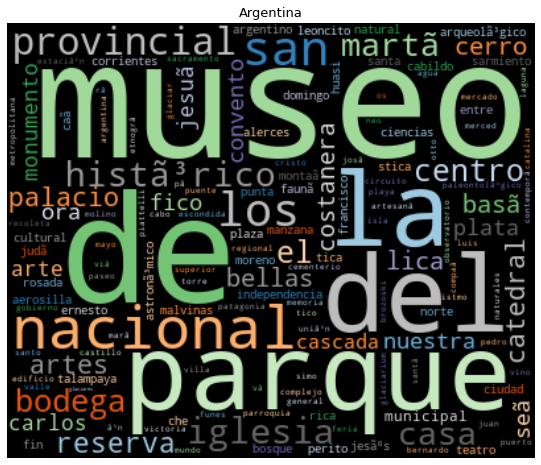

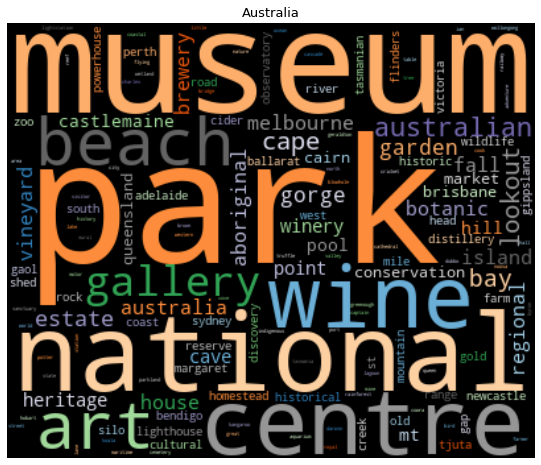

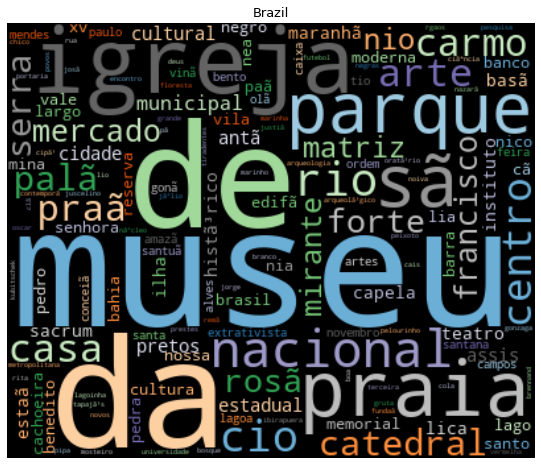

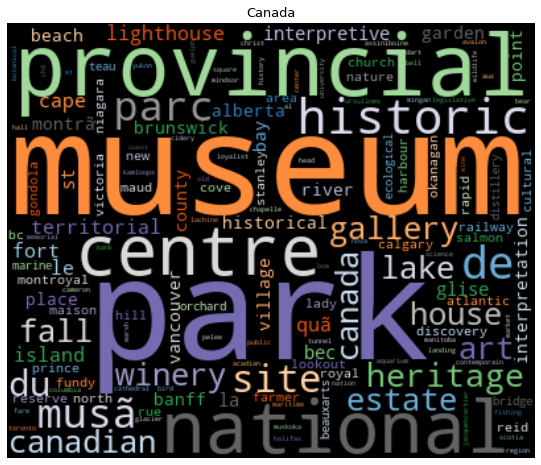

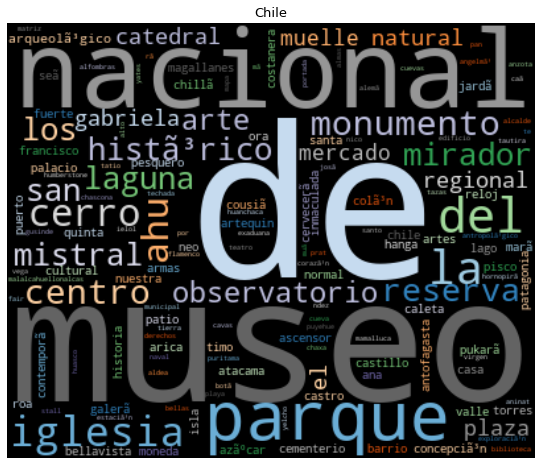

...

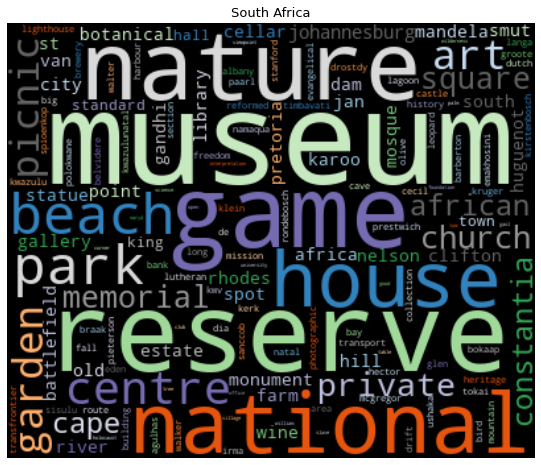

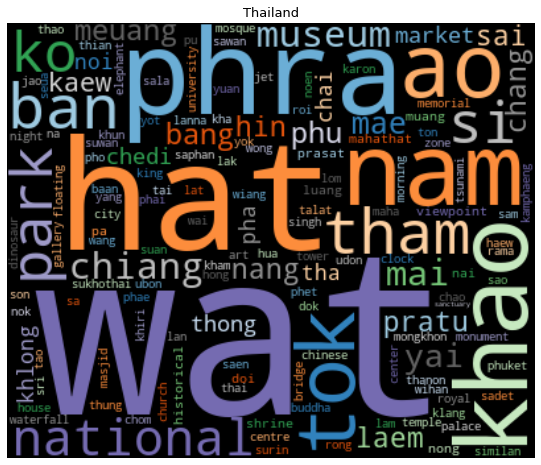

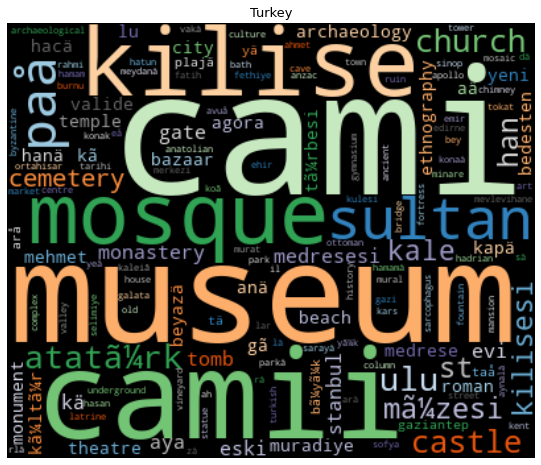

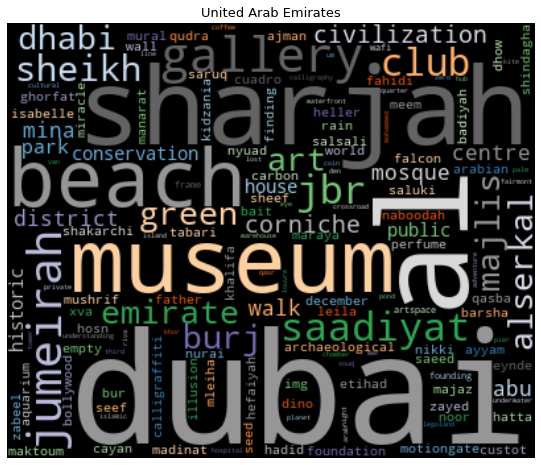

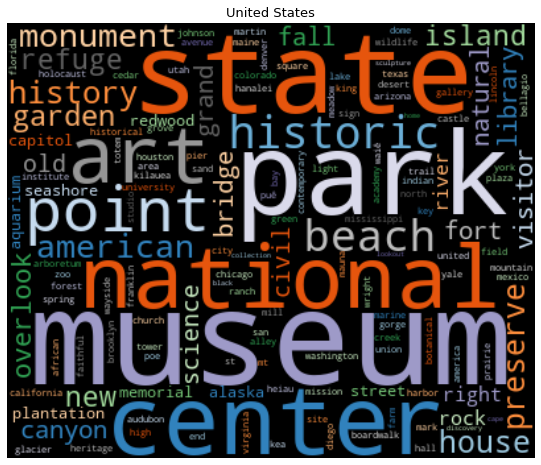

In [115]:
# Transposing document term matrix
df_dtm2 = df_dtm2.transpose()

# Plotting word cloud for each city
for index, Country in enumerate(df_dtm2.columns):
    generate_wordcloud(df_dtm2[Country].sort_values(ascending=False), Country)

In [116]:
# Look at top words with tf-idf vectorization (for total words, not per city)
sum_words = data2.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in tfidf.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
words_freq

[('museum', 5.45417461492245),
 ('de', 4.155517121713543),
 ('park', 2.7403631248560245),
 ('museo', 2.2199536183642947),
 ('national', 2.1093724918831662),
 ('temple', 1.7066749950979285),
 ('art', 1.4642366905746542),
 ('al', 1.4221377798619281),
 ('beach', 1.3721631997411539),
 ('la', 1.2735848573933943),
 ('centre', 1.2209300746650495),
 ('st', 0.9864338483272046),
 ('church', 0.9515175802666916),
 ('parque', 0.9504439929929689),
 ('garden', 0.9274600479012342),
 ('house', 0.9194155867745848),
 ('nacional', 0.9084429840705004),
 ('musã', 0.9022244674329708),
 ('gallery', 0.9009869344804079),
 ('mosque', 0.8912259386816095),
 ('reserve', 0.8850344575431116),
 ('del', 0.8310798862453376),
 ('wat', 0.8198003900364262),
 ('di', 0.8005392902983953),
 ('tomb', 0.779772351120184),
 ('san', 0.7353308093263408),
 ('hill', 0.7017881179475436),
 ('cave', 0.6541839357835114),
 ('lookout', 0.6259241404330783),
 ('lake', 0.6249472970641106),
 ('dubai', 0.624876082347646),
 ('island', 0.608172211

**In contrast, there is not as much overlap with these words as in the count vectorization because tf-idf vectorization is finding more words that are unique to the cities. This tells us that tf-idf vectorization is probably a better vectorization technique to use while modeling in order to best predict the cities.**

#### Word Clouds with Bi-Grams

In [117]:
cv2 = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=(2,2))
data3 = cv2.fit_transform(df_grouped['lemmatized'])
df_dtm3 = pd.DataFrame(data3.toarray(), columns=cv2.get_feature_names())
df_dtm3.index = df_grouped.index
df_dtm3

,aachen junges,aachener dom,aath havelis,ab al,ab samadai,ab sharm,aba cementerios,abaca naag,abad st,abakh hoja,...,zå shigayareien,zç miã,zç umç,ã³n arco,ã³n de,ã³n del,ãºcar copacabana,ã¼k akä,ã¼k kilese,ã¼å culinary
Country,,,,,,,,,,,,,,,,,,,,,
Argentina,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,0,0
Australia,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Brazil,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Canada,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Chile,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
China,0,0,0,0,0,0,0,0,0,1,...,0,1,1,0,0,0,0,0,0,0
Egypt,0,0,0,1,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Fiji,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
France,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


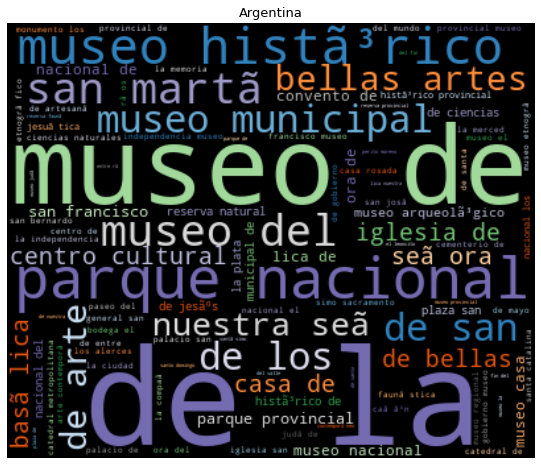

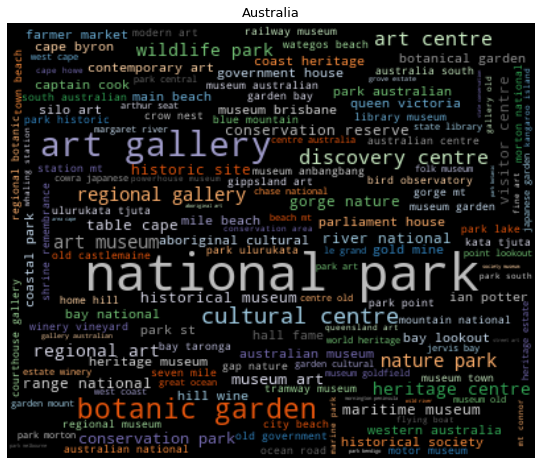

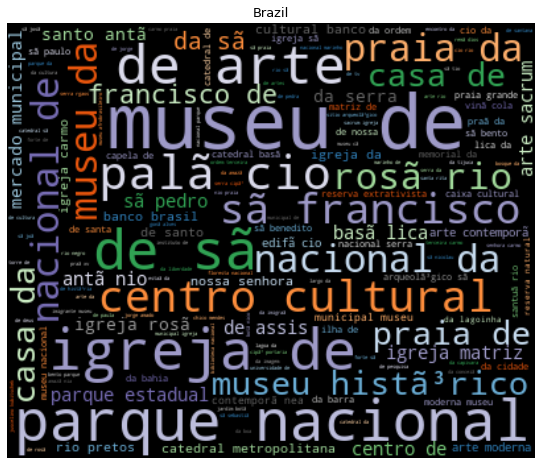

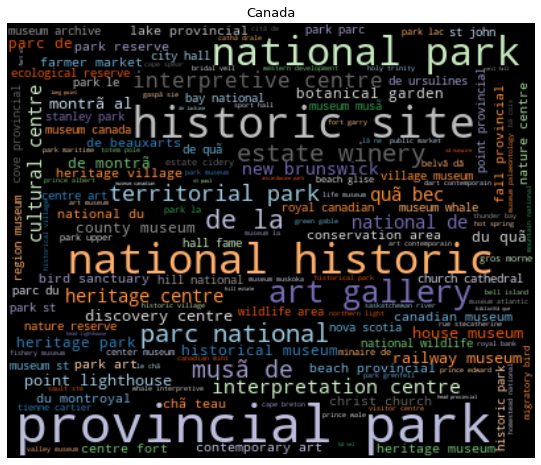

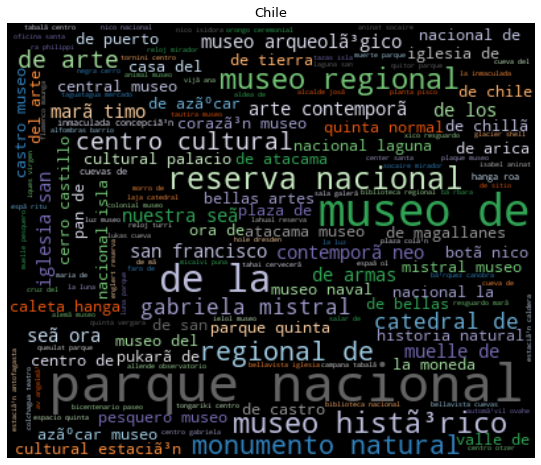

...

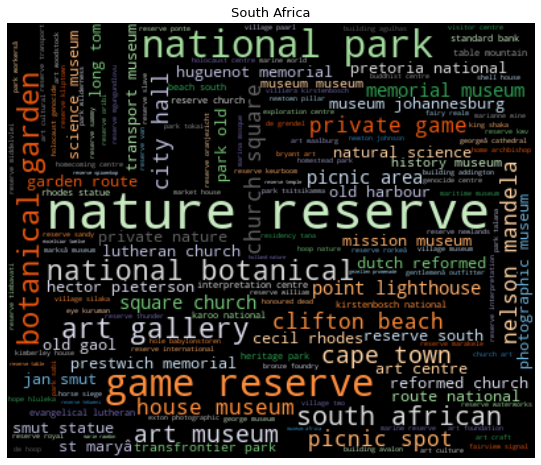

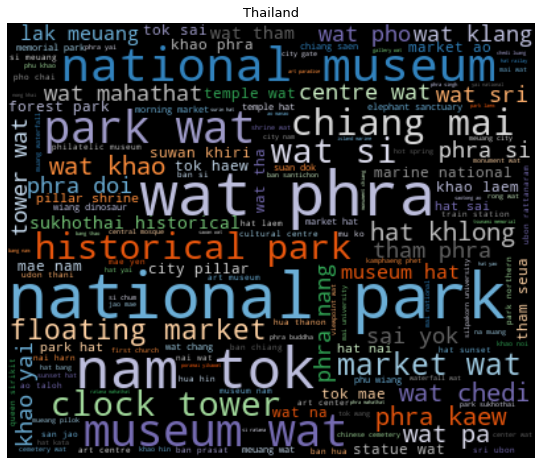

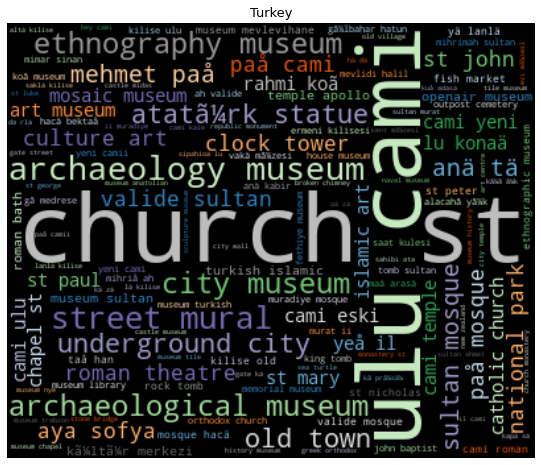

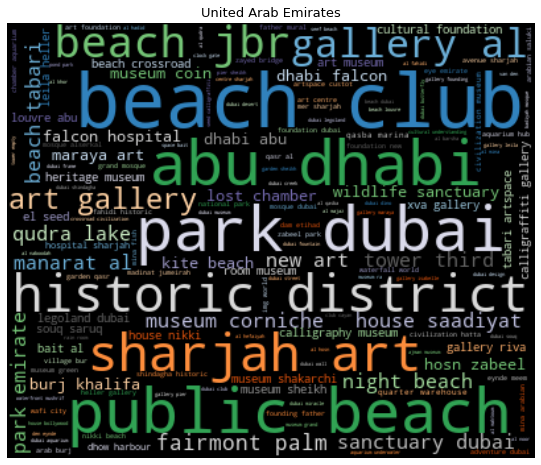

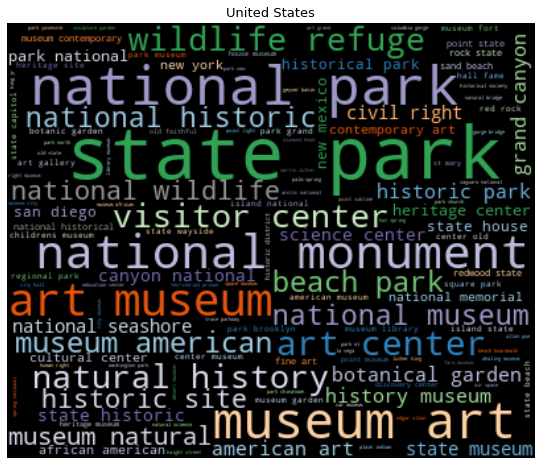

In [118]:
# Transposing document term matrix
df_dtm3 = df_dtm3.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm3.columns):
    generate_wordcloud(df_dtm3[city].sort_values(ascending=False), city)

In [119]:
# Look at top bi-grams (in total, not per city)
sum_words = data3.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in cv2.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
words_freq

[('de la', 359),
 ('national park', 268),
 ('museo de', 154),
 ('di san', 112),
 ('musã de', 102),
 ('art museum', 83),
 ('art gallery', 80),
 ('de san', 74),
 ('parque nacional', 70),
 ('chã teau', 67),
 ('chiesa di', 67),
 ('de arte', 66),
 ('museum art', 64),
 ('provincial park', 64),
 ('historic site', 57),
 ('di santa', 57),
 ('state park', 55),
 ('museo del', 54),
 ('nature reserve', 53),
 ('cathã drale', 53),
 ('basilica di', 51),
 ('iglesia de', 50),
 ('national historic', 50),
 ('templo de', 48),
 ('teau de', 45),
 ('de los', 43),
 ('casa de', 43),
 ('national museum', 42),
 ('santa maria', 41),
 ('centro cultural', 40),
 ('church st', 37),
 ('botanical garden', 35),
 ('palacio de', 34),
 ('de lâ', 34),
 ('wat phra', 32),
 ('museo archeologico', 29),
 ('nuestra seã', 28),
 ('seã ora', 28),
 ('san francisco', 27),
 ('museo histã³rico', 27),
 ('nacional de', 27),
 ('museu de', 27),
 ('notre dame', 27),
 ('botanic garden', 26),
 ('cultural centre', 26),
 ('memorial museum', 26),


**The bi-grams were able to pick out important terms, such as 'windsor castle' for London, and 'cooking class' for Sicily. However, words like 'tour' are creating some noise in most of these cities.**

## Removing Noise from the Data

Since there are still lots of words in the word clouds like 'private', 'airport' and 'transfer', I want to try to take those attractions for airport transfers out because they are causing noise in the data.